In [2]:
import numpy as np
import scipy
import robust_mean_estimate as rl
import importlib as il
from scipy import special
from numpy import linalg as LA
import matplotlib.pyplot as plt
%matplotlib inline
import mpld3
mpld3.enable_notebook()

fsize = 20
fpad = 10
figsize = (8,4)
fontname = 'fantasy'

In [3]:
"loss, time vs dimension -- Cauchy -- dense biased -- set data"

il.reload(rl)

trials = 50

m, k, eps = 500, 4, 0.05
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-dimension-Cauchy.pkl'
plot_d = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_d.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[12.54067643 -4.5231068  -1.05158472 ... -0.59421302  1.98342391
  -1.57961146]
 [ 9.70607497 -3.47387013 -1.86216919 ...  2.61441917 -0.10370938
  -0.09457261]
 [ 9.64339165 -3.71274154 -3.39593239 ... -1.11928099  0.45808544
   2.31694159]
 ...
 [ 8.74466154 -7.48120505 -3.43422817 ... -2.78830357 -8.27353042
  -4.89451852]
 [ 6.9286304  -5.70759377 -9.82433388 ...  7.44627376 -3.37279945
  -4.01795578]
 [ 7.27786201 -7.07075109 48.7953173  ... -1.21502054 -3.92670908
  -4.274443  ]]
ATTENTION
[[0.663975643172127],[-2.622797981830851],[-5.000727790892562],[9.518763388476607]]
[3 2 1 0]
[ 9.64240565e+00 -5.21206664e+00 -2.27163748e+00  8.33232954e-01
  3.96258008e-04  3.01675195e-06 -8.06563523e-05 -8.21438980e-07
 -8.06563523e-05 -1.78840842e-04  3.01675195e-06  8.21438980e-07
 -3.01675195e-06  8.21438980e-07 -2.09591556e-02 -1.94159532e-03
 -8.77417592e-04 -8.06563523e-05  1.78840842e-04 -7.23924787e-06
 -8.06563523e-05  8.21438980e-07 -1.63198578e-05 -1.78840842e-04
 -7.23924787e-

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:380: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:398: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


ATTENTION
[[1.2587963618024816],[-2.225275620367175],[-4.887717845008986],[9.957958713794024]]
[3 2 1 0]
[ 9.94918109e+00 -4.92460438e+00 -2.13850180e+00  1.01427641e+00
 -8.77417592e-04  7.23924787e-06 -3.96258008e-04 -3.01675195e-06
 -3.01675195e-06  1.63198578e-05 -1.63198578e-05  3.96258008e-04
 -2.09591556e-02 -8.21438980e-07  1.78840842e-04 -1.63198578e-05
  3.63352618e-05  7.23924787e-06 -3.63352618e-05 -8.21438980e-07
 -8.21438980e-07 -9.48946746e-03 -8.77417592e-04 -8.21438980e-07
 -1.94159532e-03 -4.29375225e-03  8.06563523e-05 -8.06563523e-05
 -2.96705319e-01 -7.23924787e-06 -3.63352618e-05  3.01675195e-06
  8.21438980e-07  8.21438980e-07  1.94159532e-03 -7.23924787e-06
  3.01675195e-06  1.63198578e-05 -3.63352618e-05 -3.01675195e-06
 -1.63198578e-05 -1.63198578e-05 -3.63352618e-05 -3.01675195e-06
 -8.06563523e-05  3.01675195e-06 -1.78840842e-04 -8.21438980e-07
 -1.62513496e-03 -7.23924787e-06  8.06013485e-02  1.63198578e-05
 -3.63352618e-05  8.21438980e-07 -7.23924787e-06 -

In [4]:
"loss vs dimension -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 500, 4, 0.05
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-Cauchy.pkl'
outputfilename = 'figs/loss-vs-dimension-Cauchy.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

NameError: name 'y' is not defined

In [ ]:
"loss vs dimension -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 500, 4, 0.05
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-Cauchy.pkl'
outputfilename = 'figs/loss-vs-dimension-Cauchy-detailed.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 500, 4, 0.05
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-Cauchy.pdf'
inputfilename = 'data/loss-time-vs-dimension-Cauchy.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 500, 4, 0.05
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-Cauchy-detailed.pdf'
inputfilename = 'data/loss-time-vs-dimension-Cauchy.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [4]:
"loss, time vs sparsity -- Cauchy -- dense biased -- set data"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.05
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)

inputfilename = 'data/loss-time-vs-sparsity-Cauchy.pkl'
plot_k = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_k.setdata_tofile(filename = inputfilename, xvar_name = 'k', trials = trials, xs = xs)

[[ 1.72830234e+00 -2.85051285e+01  3.11473205e+00 ...  3.36802115e-02
  -9.98793217e-01 -2.72053803e-01]
 [-4.49313642e-01 -7.12573114e-01 -1.27710148e+02 ...  3.80007826e-01
  -5.76305940e+01  1.01141638e+00]
 [ 5.66994364e-01  5.52024250e+00  1.35133301e+00 ... -1.32146785e-01
  -2.85472105e-02  9.08680096e-02]
 ...
 [-1.26602314e+00 -3.41497712e+00 -1.11565369e+00 ... -2.47464064e+00
  -4.13091269e+00 -2.14902228e+00]
 [ 3.50620376e-01 -2.15639051e+00 -1.92915208e+00 ... -4.03711690e+00
  -3.27637315e+00 -8.17178183e+00]
 [ 4.24755951e-01 -1.41194812e+00 -1.72078107e+00 ... -1.85636971e+00
  -1.02045450e+00 -1.30481000e+00]]
ATTENTION
[[-0.40645637704979065],[1.019548723971667],[1.429970550857754],[0.5334291097088469]]
[89  0  3  1]
[ 7.51694596e-01  7.97927094e-01  1.96699344e-02  1.03265508e+00
  2.80995436e-01 -5.41460901e-05  7.23924787e-06 -3.96258008e-04
 -3.96258008e-04 -1.93615497e-02 -7.23924787e-06  3.96258008e-04
 -7.23924787e-06 -2.88756694e-03 -1.46813599e-01 -1.7327383

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:382: RuntimeWarning: invalid value encountered in double_scalars
  else:
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:400: RuntimeWarning: invalid value encountered in double_scalars
  else:


ATTENTION
[[0.7045147741959114],[0.8697263897189635],[0.20153729285542754],[-0.4533829690798282],[0.7779318669149419],[0.9972429965441916],[0.6437687839328593],[1.5036286970365929]]
[ 3  5  7 96  0  4  1  6]
[ 7.65226738e-01  8.38358151e-01  6.12314207e-01  6.16754733e-01
  1.06316672e+00  6.96274724e-01  1.39202805e+00  6.49300232e-01
  5.41460901e-05  5.41460901e-05 -5.41460901e-05 -5.41460901e-05
  0.00000000e+00 -2.88756694e-03  0.00000000e+00 -5.41460901e-05
  1.07369101e-01 -3.15827519e-04 -2.09591556e-02 -1.20798014e-02
  1.49745667e-01 -2.09591556e-02 -3.96258008e-04  2.88756694e-03
 -7.91981438e-02  2.88756694e-03 -3.96258008e-04  3.96258008e-04
  3.96258008e-04 -2.09591556e-02 -7.23924787e-06 -5.41460901e-05
 -7.23924787e-06  5.41460901e-05  7.23924787e-06  5.41460901e-05
  1.97491556e-02 -1.51534843e-01 -5.41460901e-05 -2.88756694e-03
 -5.41460901e-05  2.88756694e-03 -2.88756694e-03 -4.27227363e-01
  7.23924787e-06  3.96258008e-04  5.41460901e-05  5.41460901e-05
 -7.23924787

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

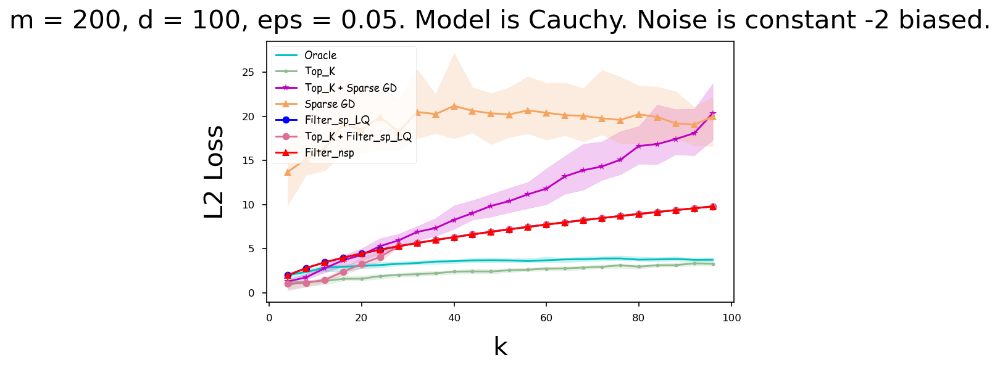

<Figure size 1200x600 with 0 Axes>

In [3]:
"loss vs sparsity -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.05
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-Cauchy.pkl'
outputfilename = 'figs/loss-vs-sparsity-Cauchy.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs sparsity -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.05
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-Cauchy.pkl'
outputfilename = 'figs/loss-vs-sparsity-Cauchy-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.05
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-Cauchy.pkl'
outputfilename = 'figs/time-vs-sparsity-Cauchy.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.05
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-Cauchy.pkl'
outputfilename = 'figs/time-vs-sparsity-Cauchy-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [5]:
"loss, time vs sample -- Cauchy -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.05
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-sample-Cauchy.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[ 10.64341544  -4.42974158  -2.7736042  ...  -1.46237385 -14.98568855
    0.49157946]
 [ 11.14175612  -5.50798526  -3.07314888 ...   0.16215514  -0.91962337
    1.31502969]
 [ 11.19239215  -5.20779111  -0.44353541 ...   0.40195098  -1.04410292
    1.03762296]
 ...
 [  7.52555579  -6.78516284  -4.13576374 ...   0.8888649   -2.45781222
   -3.81344324]
 [  5.38210423  -5.18974624  -1.79055497 ...  -3.06560804  -3.86876859
   -1.33088783]
 [  7.6868895   -7.25429286   2.70601781 ...  -1.9564951   -1.38305062
   -2.77112457]]
ATTENTION
[[0.8130486946981514],[-5.2254639404822445],[-1.9405212432610346],[9.769138190885297]]
[3 1 2 0]
[ 9.95013716e+00 -5.27562903e+00 -2.06238807e+00  8.33315734e-01
 -7.23924787e-06 -8.06563523e-05 -8.77417592e-04  8.06563523e-05
 -7.23924787e-06  1.63198578e-05 -1.94855937e-02 -8.06563523e-05
 -3.63352618e-05  1.78840842e-04  1.63198578e-05  8.21438980e-07
 -3.63352618e-05 -8.21438980e-07 -8.06563523e-05  3.63352618e-05
  3.01675195e-06 -1.63198578e-05  3.0167

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:382: RuntimeWarning: invalid value encountered in double_scalars
  else:
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:400: RuntimeWarning: invalid value encountered in double_scalars
  else:


ATTENTION
[[0.8958986351481506],[-1.4092349537640976],[-4.940206619897179],[9.150077826952316]]
[3 2 1 0]
[ 9.67922636e+00 -4.95168965e+00 -1.58690733e+00  7.46553980e-01
  1.78840842e-04  8.21438980e-07  3.01675195e-06 -8.21438980e-07
 -8.77417592e-04  1.65762662e-02  3.01675195e-06  1.63198578e-05
 -1.78840842e-04  8.06563523e-05  9.48946746e-03 -1.94159532e-03
 -8.21438980e-07  1.63198578e-05  3.96258008e-04 -8.21438980e-07
 -8.21438980e-07  3.63352618e-05 -3.01675195e-06 -3.01675195e-06
 -7.23924787e-06 -1.94159532e-03  3.01675195e-06 -3.01675195e-06
  7.23924787e-06 -8.06563523e-05 -4.12670165e-03 -8.77417592e-04
  8.21438980e-07 -7.23924787e-06 -1.63198578e-05 -3.01675195e-06
 -3.63352618e-05 -3.63352618e-05 -1.63198578e-05 -7.23924787e-06
 -1.63198578e-05 -1.78840842e-04  7.23924787e-06 -3.01675195e-06
 -8.06563523e-05 -7.23924787e-06 -8.21438980e-07  3.01675195e-06
 -3.96258008e-04 -3.01675195e-06 -3.01675195e-06 -3.63352618e-05
 -8.06563523e-05 -3.01675195e-06  8.21438980e-07 

In [ ]:
"loss vs sample -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.05
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-Cauchy.pkl'
outputfilename = 'figs/loss-vs-sample-Cauchy.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs sample -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.05
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-Cauchy.pkl'
outputfilename = 'figs/loss-vs-sample-Cauchy-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.05
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-Cauchy.pkl'
outputfilename = 'figs/time-vs-sample-Cauchy.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.05
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-Cauchy.pkl'
outputfilename = 'figs/time-vs-sample-Cauchy-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss, time vs eps -- Cauchy -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.GaussianNoise()
model_params = rl.Params(d = d, k = k, m = m)

inputfilename = 'data/loss-time-vs-eps-Cauchy.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'eps', trials = trials, xs = xs)

In [ ]:
"loss vs eps -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.GaussianNoise()
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-Cauchy.pkl'
outputfilename = 'figs/loss-vs-eps-Cauchy.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Cauchy. Noise is Gaussian.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs eps -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.CauchyModel()
noise_model = rl.GaussianNoise()
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-Cauchy.pkl'
outputfilename = 'figs/loss-vs-eps-Cauchy-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Cauchy. Noise is Gaussian.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- Cauchy -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-Cauchy.pkl'
outputfilename = 'figs/time-vs-eps-Cauchy.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- Cauchy -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.CauchyModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-Cauchy.pkl'
outputfilename = 'figs/time-vs-eps-Cauchy-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Cauchy. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)